<a href="https://colab.research.google.com/github/shafaattahir/py/blob/master/Data_Augmn.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import os
import numpy as np
import pandas as pd
import seaborn as sns
import cv2
from pylab import rcParams
from tqdm import tqdm
import matplotlib.pyplot as plt
from matplotlib import rc
from pandas.plotting import register_matplotlib_converters
import albumentations as A
import random

%matplotlib inline
%config InlineBackend.figure_format='retina'

register_matplotlib_converters()
sns.set(style='whitegrid', palette='muted', font_scale=1.2)

HAPPY_COLORS_PALETTE = ["#01BEFE", "#FFDD00", "#FF7D00", "#FF006D", "#ADFF02", "#8F00FF"]

sns.set_palette(sns.color_palette(HAPPY_COLORS_PALETTE))

rcParams['figure.figsize'] = 12, 8

RANDOM_SEED = 42

random.seed(RANDOM_SEED)
np.random.seed(RANDOM_SEED)

In [3]:
!unzip -q MyData.zip

In [4]:
!ls

MyData	MyData.zip  sample_data


In [2]:
BOX_COLOR = (255, 0, 0)

def visualize_bbox(img, bbox, color=BOX_COLOR, thickness=2):
    x_min, y_min, x_max, y_max = map(lambda v: int(v), bbox)
    
    cv2.rectangle(img, (x_min, y_min), (x_max, y_max), color=color, thickness=thickness)
    return img

In [3]:
def show_image(image, bbox):
  image = visualize_bbox(image.copy(), bbox)
  f = plt.figure(figsize=(18, 12))
  plt.imshow(
    cv2.cvtColor(image, cv2.COLOR_BGR2RGB),
    interpolation='nearest'
  )
  plt.axis('off')
  f.tight_layout()
  plt.show()

In [21]:
form = cv2.imread("/content/G0010035.jpg")
STUDENT_ID_BBOX = [420, 775, 492, 791]



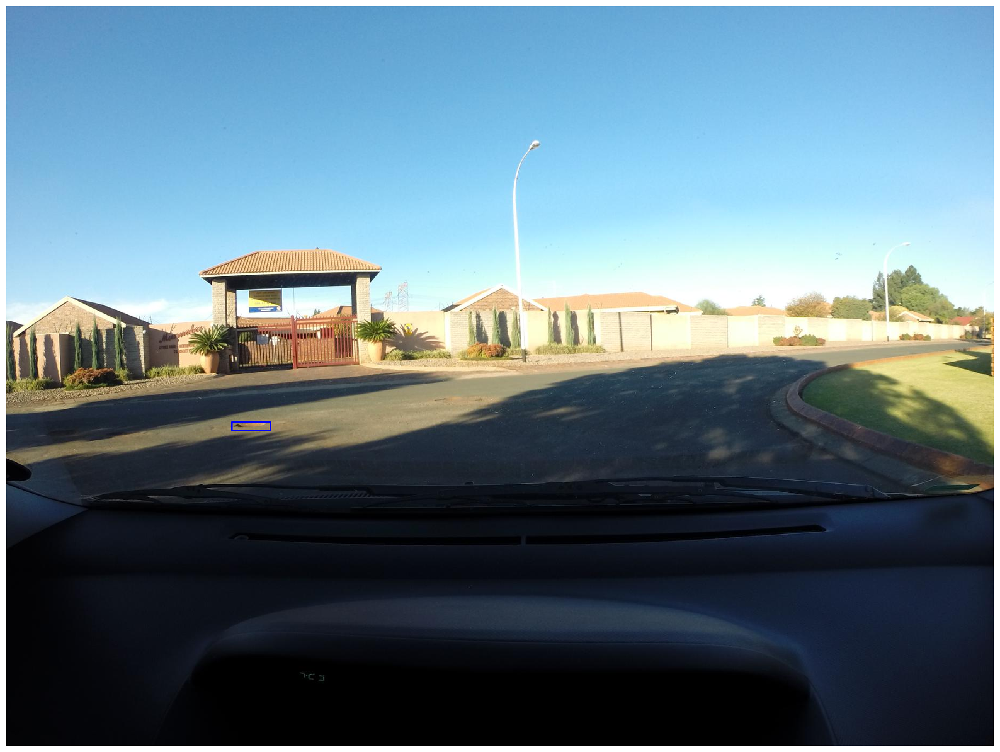

In [22]:
show_image(form, bbox=STUDENT_ID_BBOX)

In [23]:
def show_augmented(augmentation, image, bbox):
  augmented = augmentation(image=image, bboxes=[bbox], field_id=['1'])
  show_image(augmented['image'], augmented['bboxes'][0])

In [24]:
# [x_min, y_min, x_max, y_max], e.g. [97, 12, 247, 212].
bbox_params = A.BboxParams(
  format='pascal_voc', 
  min_area=1, 
  min_visibility=0.5, 
  label_fields=['field_id']
)

In [19]:
!pip install --upgrade albumentations

     |████████████████████████████████| 98 kB 3.5 MB/s 
     |████████████████████████████████| 37.1 MB 51 kB/s 
  Attempting uninstall: albumentations
    Found existing installation: albumentations 0.1.12
    Uninstalling albumentations-0.1.12:
      Successfully uninstalled albumentations-0.1.12


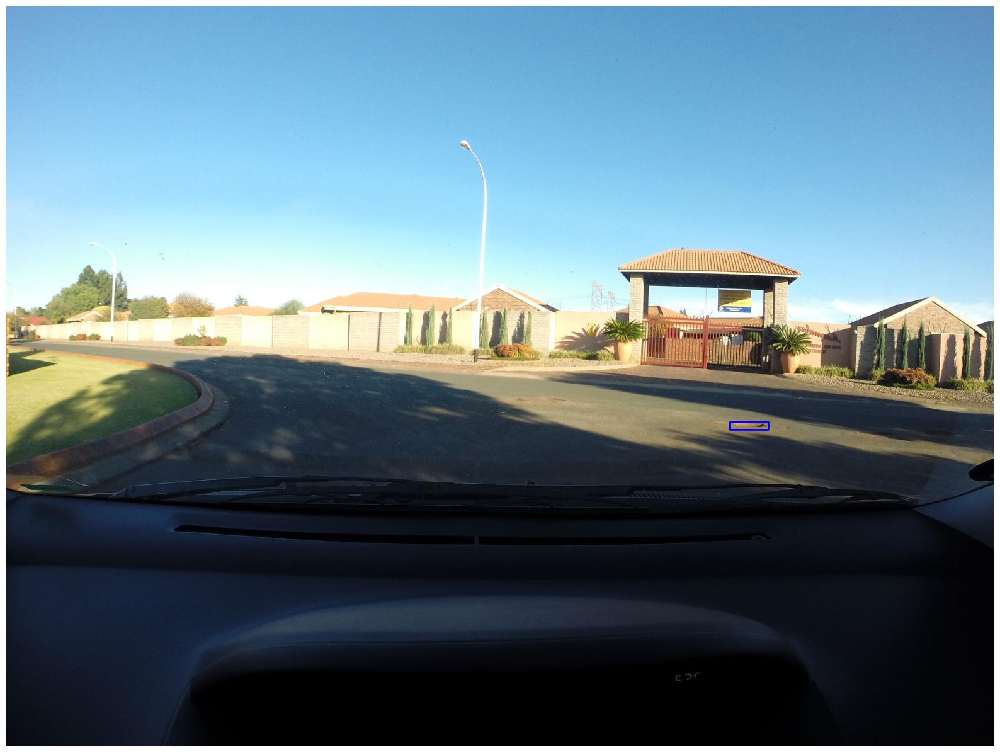

In [25]:
aug = A.Compose([
    A.Flip(always_apply=True)
], bbox_params=bbox_params)



show_augmented(aug, form, STUDENT_ID_BBOX)

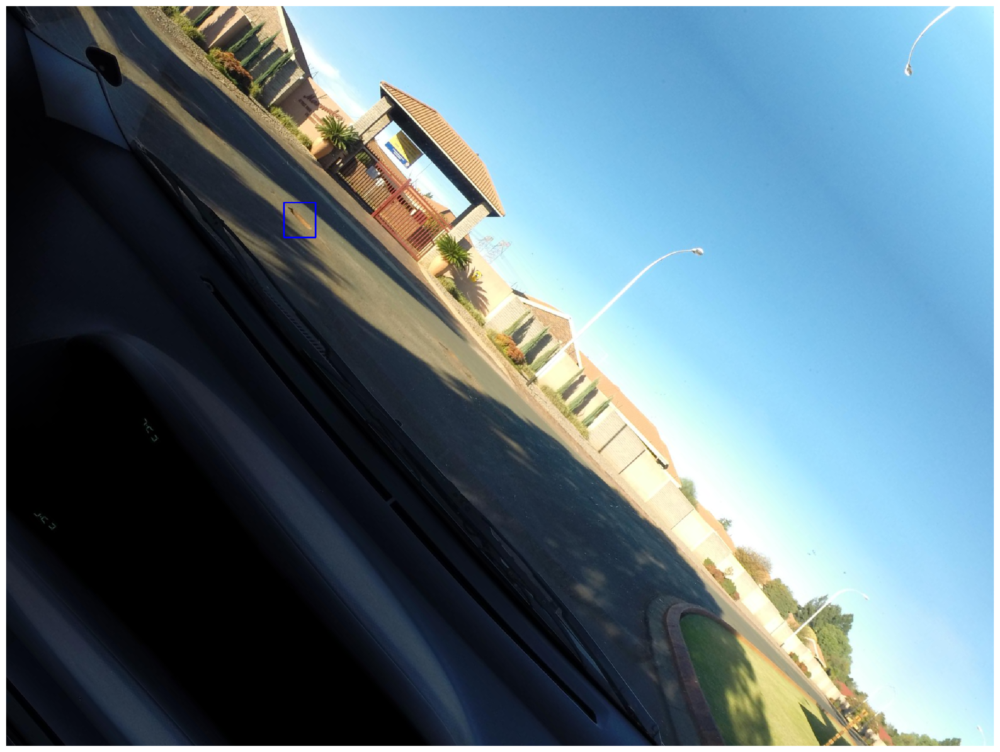

In [26]:
aug = A.Compose([
  A.Rotate(limit=80, always_apply=True)
], bbox_params=bbox_params)

show_augmented(aug, form, STUDENT_ID_BBOX)

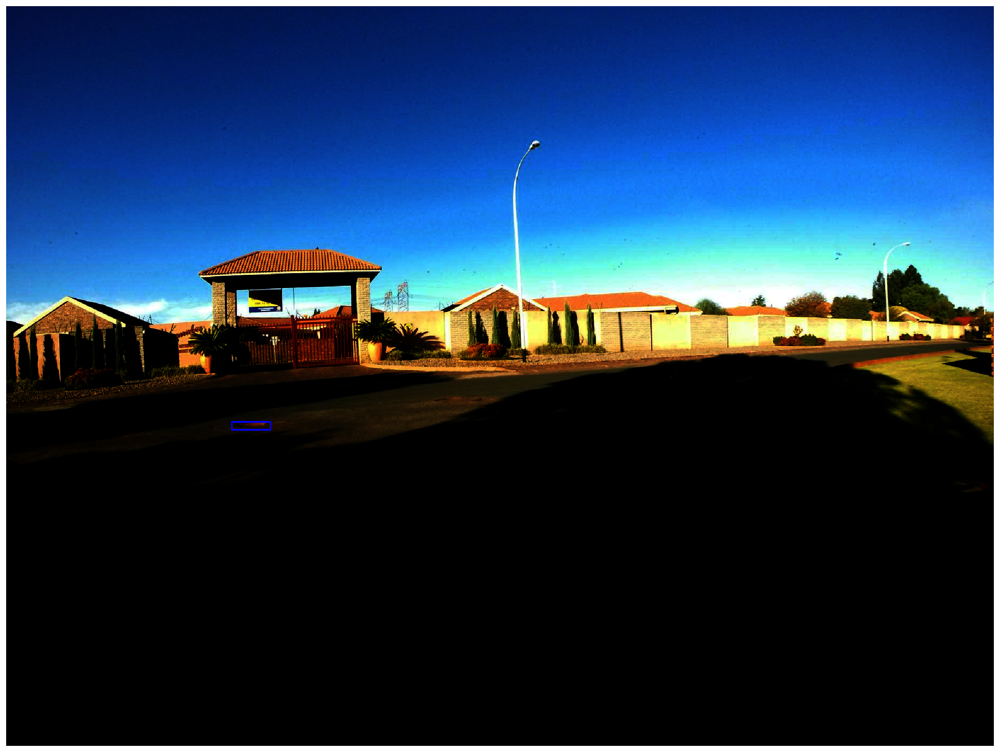

In [27]:
aug = A.Compose([
    A.RandomGamma(gamma_limit=(400, 500), always_apply=True)
], bbox_params=bbox_params)

show_augmented(aug, form, STUDENT_ID_BBOX)

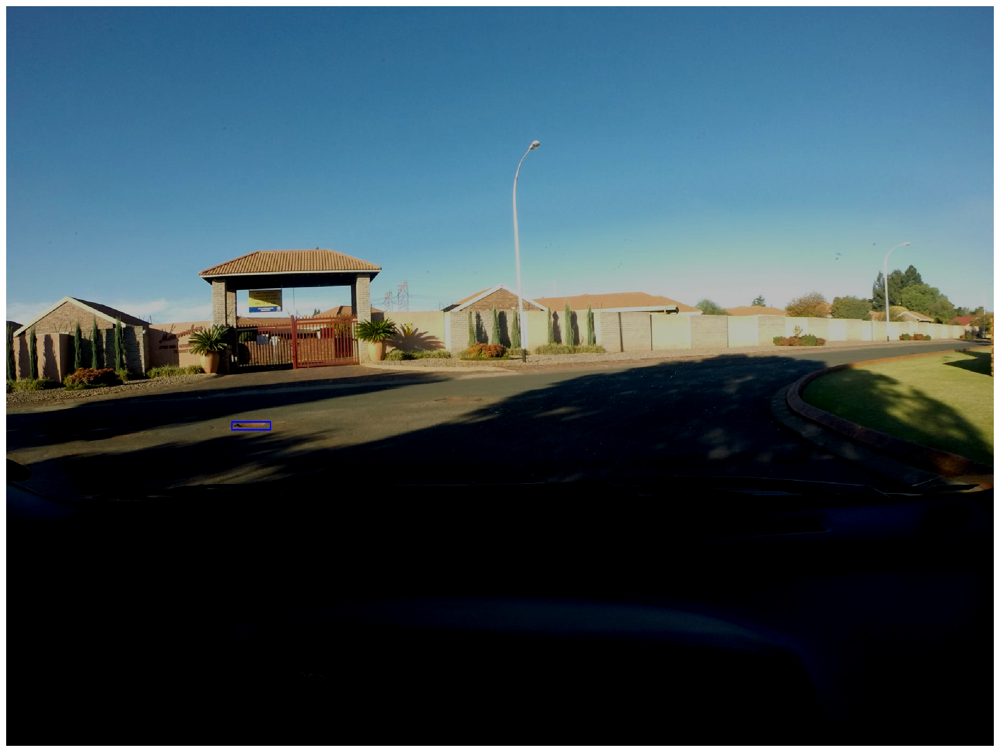

In [28]:
aug = A.Compose([
    A.RandomBrightnessContrast(always_apply=True),
], bbox_params=bbox_params)

show_augmented(aug, form, STUDENT_ID_BBOX)

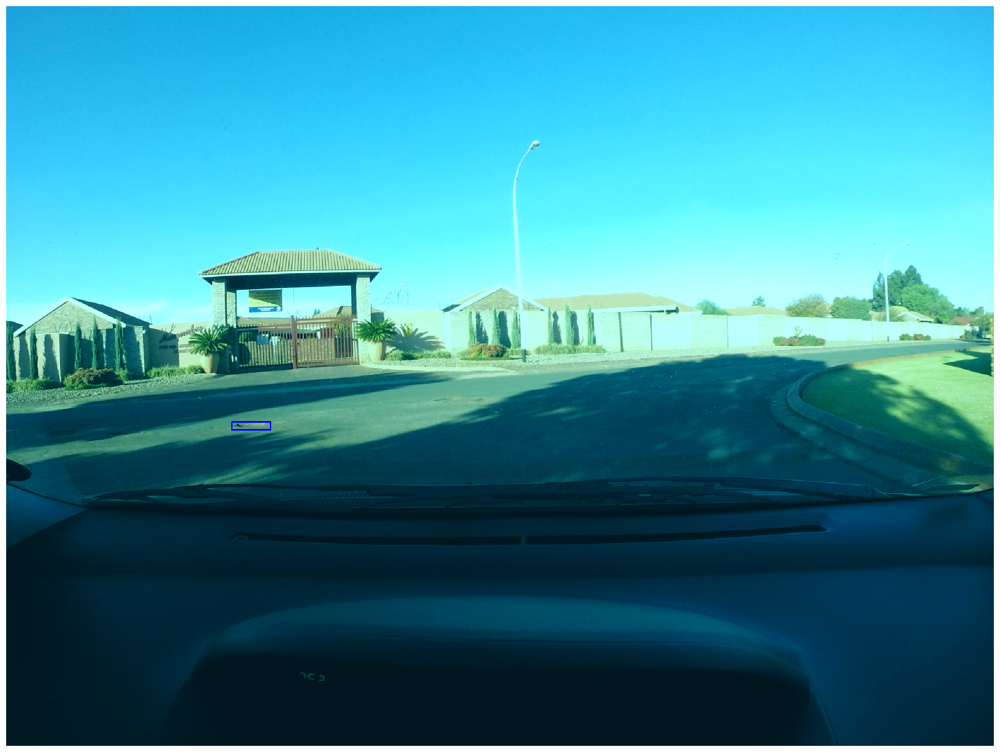

In [30]:
aug = A.Compose([
    A.RGBShift(
      always_apply=True, 
      r_shift_limit=100, 
      g_shift_limit=100,
      b_shift_limit=100
    ),
], bbox_params=bbox_params)

show_augmented(aug, form, STUDENT_ID_BBOX)

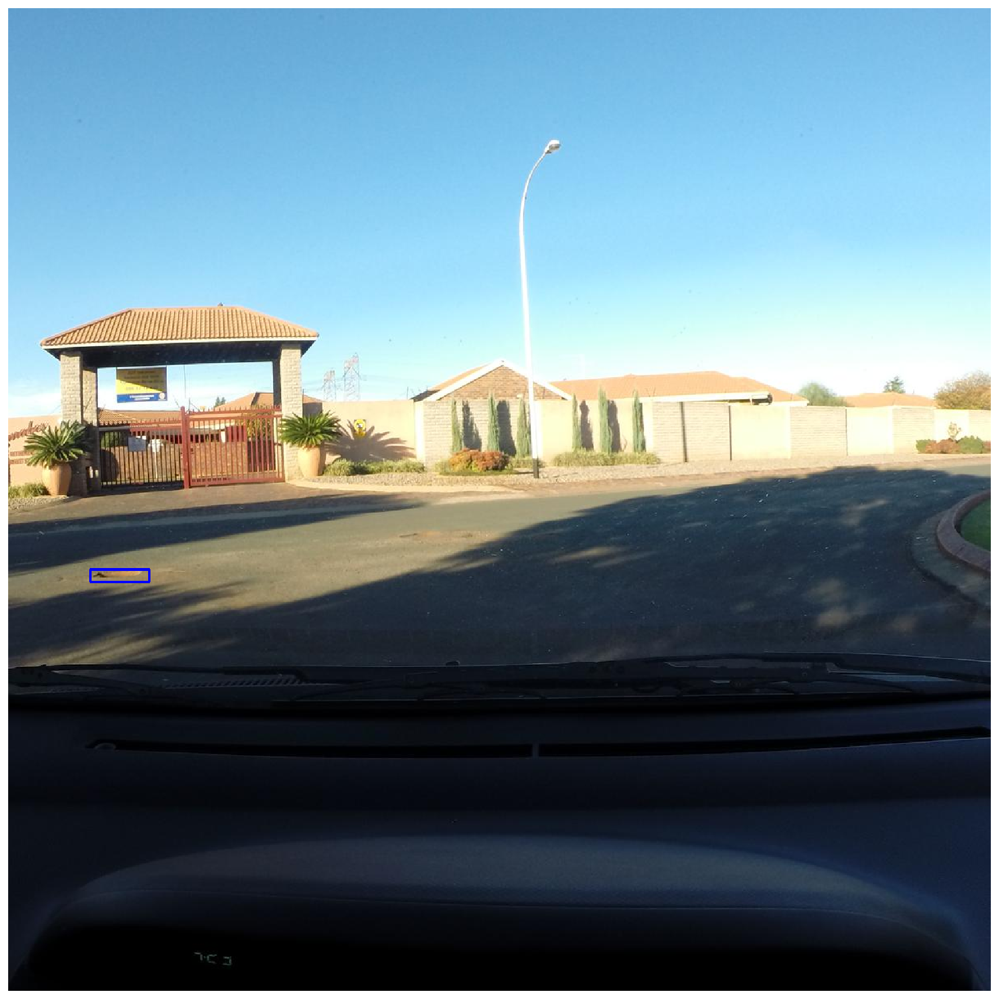

In [45]:
aug=A.Compose([
           A.CenterCrop(width=1200,height=1200,p=1),          
],
bbox_params=bbox_params)


show_augmented(aug, form, STUDENT_ID_BBOX)

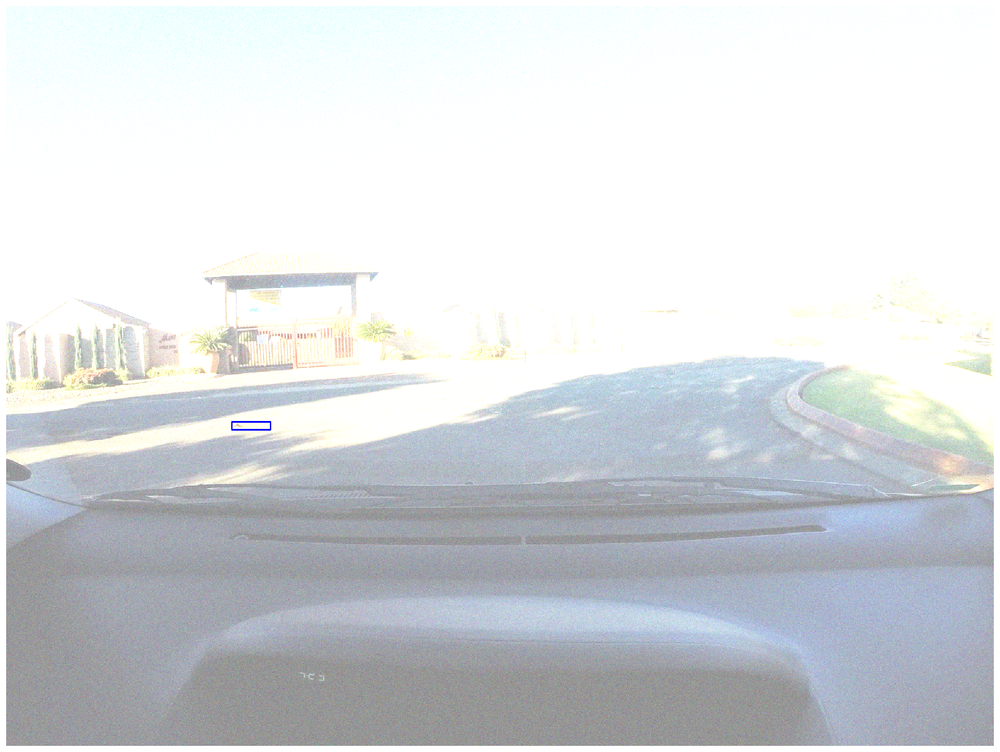

In [31]:
aug = A.Compose([
    A.GaussNoise(
      always_apply=True,
      var_limit=(100, 300),
      mean=150
    ),
], bbox_params=bbox_params)

show_augmented(aug, form, STUDENT_ID_BBOX)

In [39]:
doc_aug = A.Compose([
    A.Flip(p=0.25),
    A.RandomGamma(gamma_limit=(20, 300), p=0.5),
    A.RandomBrightnessContrast(p=0.85),
    A.Rotate(limit=35, p=0.9),
    A.RandomRotate90(p=0.25),
    A.RGBShift(p=0.75),
    A.GaussNoise(p=0.25)
], bbox_params=bbox_params)

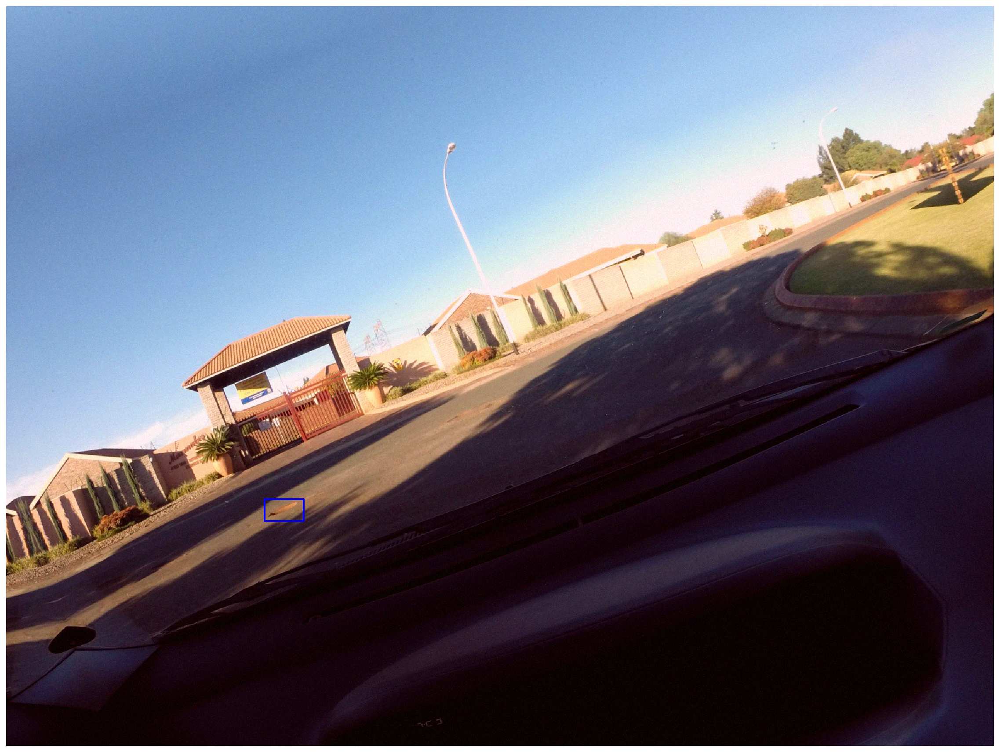

429 813


In [40]:
show_augmented(doc_aug, form, STUDENT_ID_BBOX)
for bbox in augmented['bboxes']:
    x_min, y_min, x_max, y_max = map(lambda v: int(v), bbox)
    print(x_min,y_min)

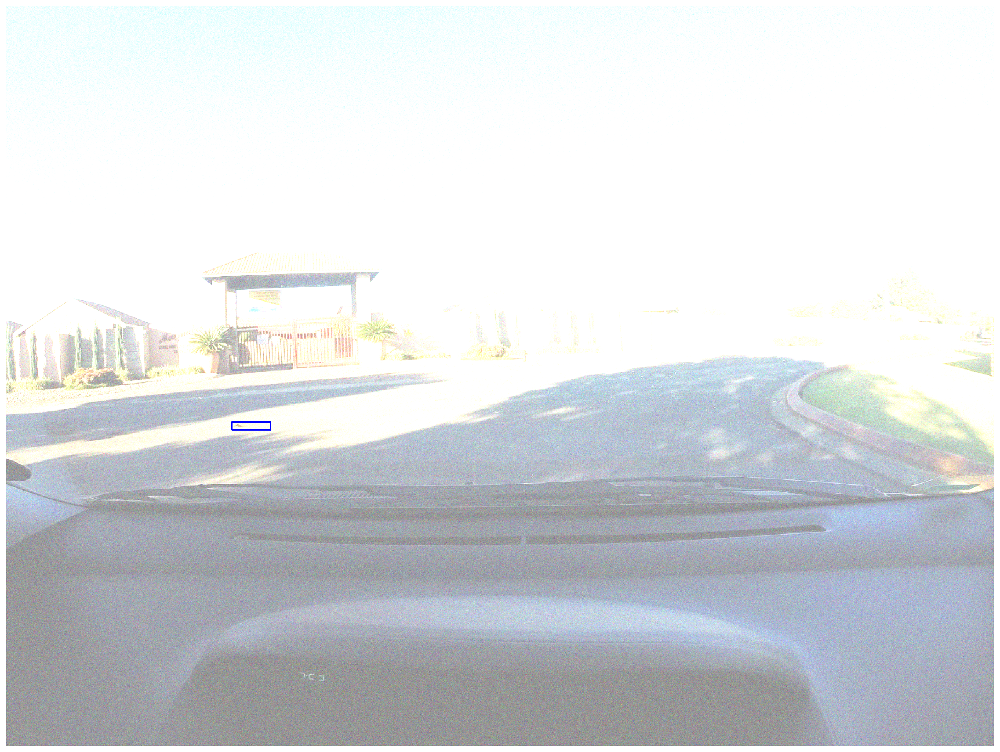

429 813


In [38]:
aug = A.Compose([
    A.GaussNoise(
      always_apply=True,
      var_limit=(100, 300),
      mean=150
    ),
], bbox_params=bbox_params)

show_augmented(aug, form, STUDENT_ID_BBOX)


In [35]:
DATASET_PATH = 'data/augmented'
IMAGES_PATH = f'{DATASET_PATH}/images'

os.makedirs(DATASET_PATH, exist_ok=True)
os.makedirs(IMAGES_PATH, exist_ok=True)

rows = []
for i in tqdm(range(100)):
  augmented = doc_aug(image=form, bboxes=[STUDENT_ID_BBOX], field_id=['1'])
  file_name = f'form_aug_{i}.jpg'
  for bbox in augmented['bboxes']:
    x_min, y_min, x_max, y_max = map(lambda v: int(v), bbox)
    rows.append({
      'file_name': f'images/{file_name}',
      'x_min': x_min,
      'y_min': y_min,
      'x_max': x_max,
      'y_max': y_max,
      'class': 'student_id'
    })

  cv2.imwrite(f'{IMAGES_PATH}/{file_name}', augmented['image'])

pd.DataFrame(rows).to_csv(f'{DATASET_PATH}/annotations.csv', header=True, index=None)

100%|██████████| 100/100 [00:24<00:00,  4.13it/s]
